In [2]:
%run "libraries.ipynb"

from IPython.display import display, HTML

In [3]:
pages = codecs.open("data/pagenames.txt","r", "utf-8-sig").readlines()
pages = map(lambda x: x.strip(), pages)

## computing page views

In [4]:
pagename = "Pi"

def get_pageviews(page):
    pageviews = json.load(codecs.open("data/pageviews/%s.json" % (page), "r", "utf-8-sig"))

    series = []
    index = []

    for m in pageviews:
        for d,v in m.iteritems():
            try:
                # print d
                index.append(pd.to_datetime(d, format="%Y-%m-%d"))
                series.append( v )
            except ValueError:
                pass
                
    
    return series, index

r,index = get_pageviews(pagename)

ts = pd.DataFrame(index=index)

#table.index

for p in pages:
    title = p
    pageviews, index = get_pageviews(title)
    ts[title] = pageviews

print len(ts.index)

2642


## computing revision history

In [5]:
def get_revisions_history(page):
    revisions = json.load(codecs.open("data/revisions/%s.json" % (page), "r", "utf-8-sig"))

    # print revisions
    
    df = pd.DataFrame(revisions)
    df["datetime"] = df.timestamp.apply(pd.to_datetime)
    
    
    # print df[["datetime","timestamp"]]
    
    df["day"] = df.datetime.apply(dt.date.strftime, args=('%Y-%m-%d',))
    
    # print df[["day","timestamp"]].head(10)
    counts = df.groupby(df["day"])
    counts = counts.aggregate(len)
    #print counts["day"].head(10)

    #print counts.head()
    # print counts.index
    
    series = counts["size"].tolist()
    index = counts.index.map(lambda x: pd.to_datetime(x, format="%Y-%m-%d"))

    return series, index

revisions_ts = pd.DataFrame(index=index)

for p in pages:
    title = p
    
    s,i = get_revisions_history(title)
    r_ts = pd.DataFrame({ title: s },index=i)
    
    revisions_ts = revisions_ts.join(r_ts)

revisions_ts = revisions_ts.fillna(0)    

#revisions_ts.head(20)

# Final report

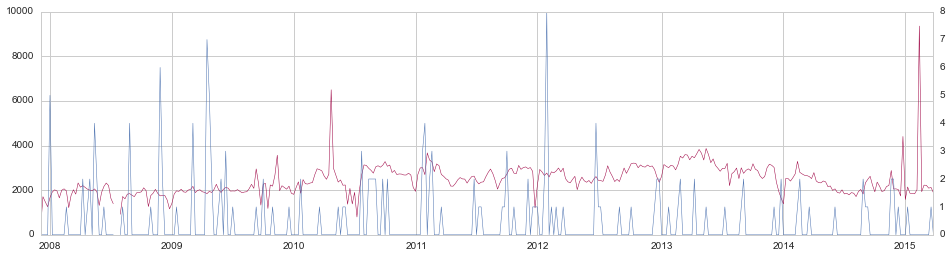

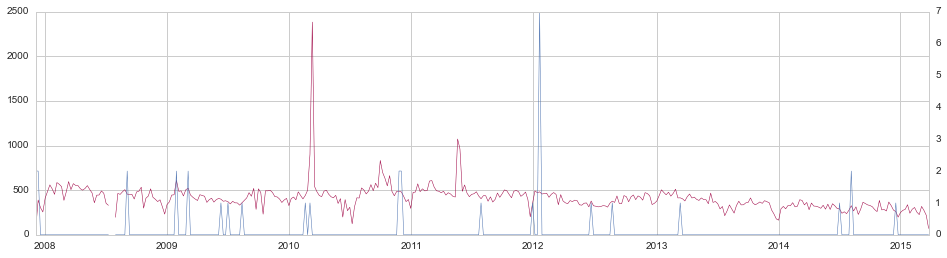

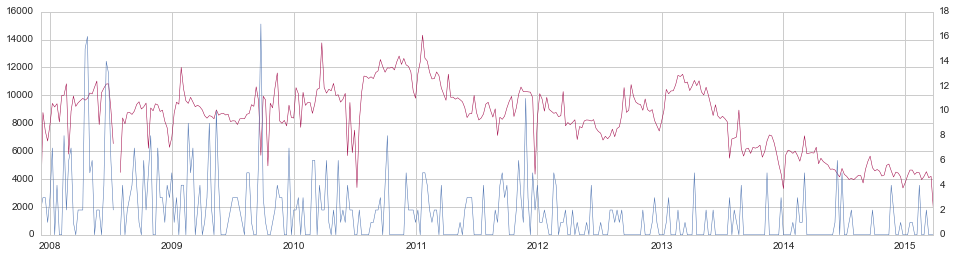

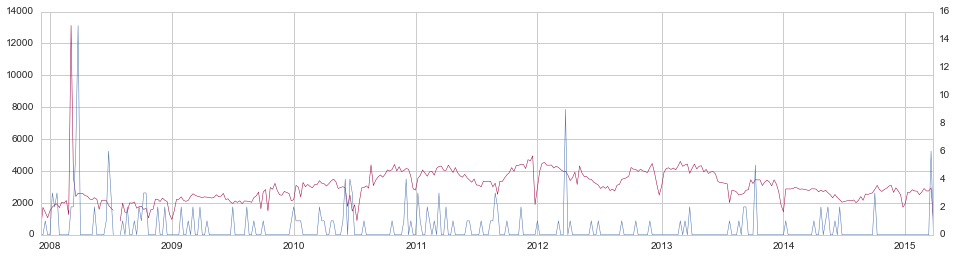

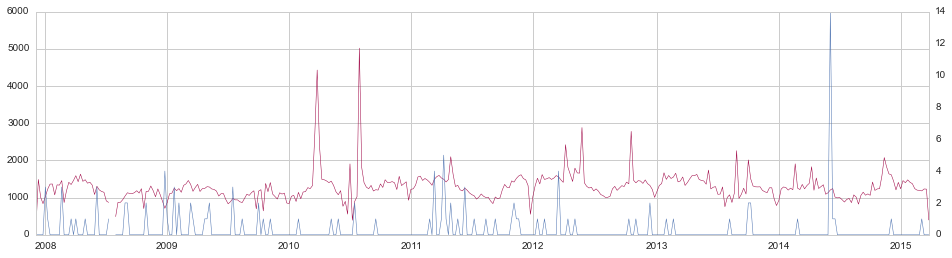

...

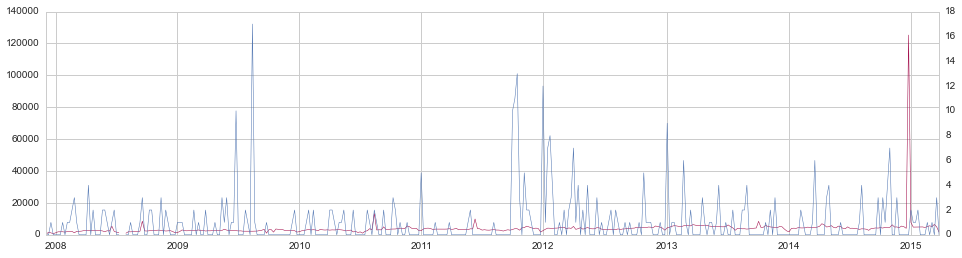

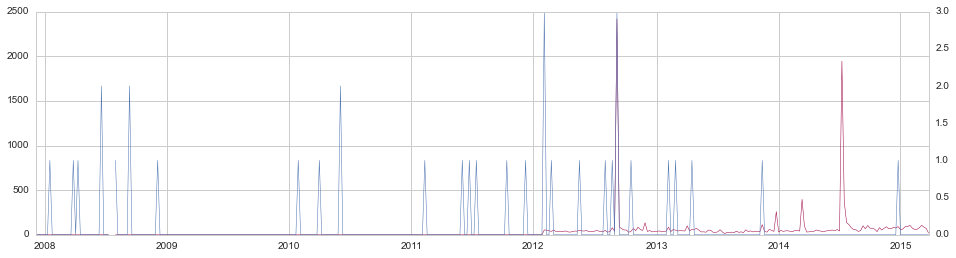

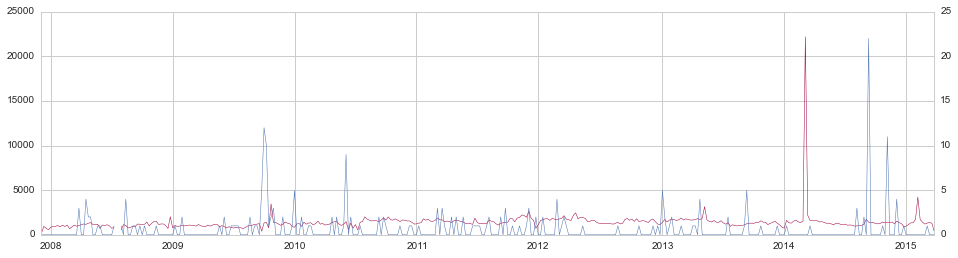

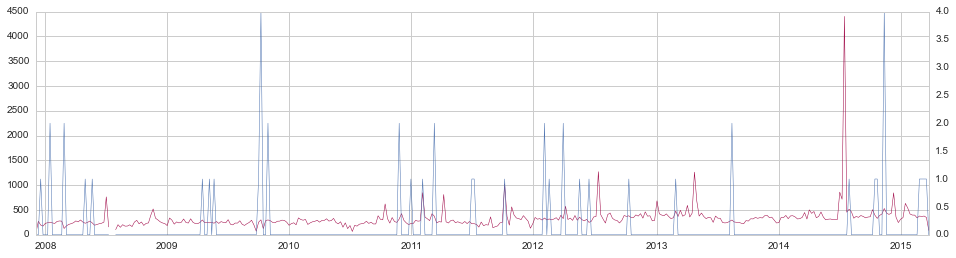

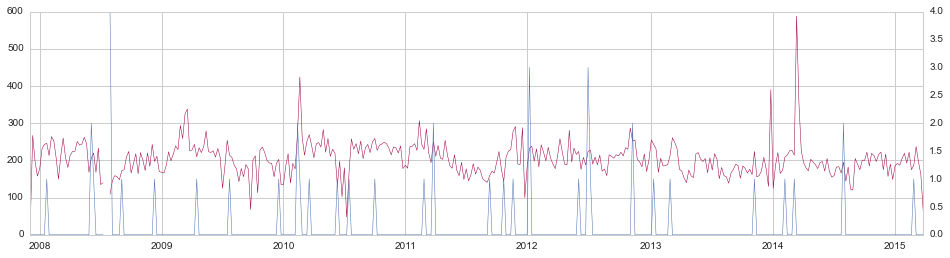

In [9]:
#fig = plt.figure()
# for p in [ "Pi" ]:
for p in pages:
    title = p
    display(HTML("<h2>%s</h2>" % (title)))
    #fig, x = plt.subplots(figsize=(16,4))
    # ax = fig.add_subplot()
    mstd = pd.rolling_std (ts[title], 30)
    ma = pd.rolling_mean(ts[title], 30)
    # print ts[title].index
    # print ma.index
    # plt.plot(ts[title].index, ts[title], color="k", linewidth="0.5",)
    # idx = pd.Index([ i for i,t in enumerate(ts.index) ])
    idx = ts.index

    ts_week = ts[title].resample("W-MON", how="sum")
    ts_month = ts[title].resample("M", how="sum")

    ts[title].to_csv("data/pageviews/%s.daily.csv" % (title))
    ts_week.to_csv("data/pageviews/%s.weekly.csv" % (title))
    ts_month.to_csv("data/pageviews/%s.monthly.csv" % (title))
   
    # ts[title].plot(figsize=(16,4), linewidth="0.5", ylim=0, colormap="Spectral", rot=0)
    ts_week.plot(figsize=(16,4), linewidth="0.5", ylim=0, colormap="Spectral", rot=0)

    #revisions_ts[title].plot(secondary_y=True, style="-", linewidth="0.5", ylim=0)

    rev_week = revisions_ts[title].resample("W-MON", how="sum")
    rev_week.plot(secondary_y=True, style="-", linewidth="0.5", ylim=0)
    #ma.plot(style='r', linewidth="0.5")
    #ax.set_xticklabels(idx, rotation=0)

    # plt.plot(idx, ma, color='r', linewidth="0.5")
    # plt.fill_between( idx, ma-2*mstd, ma+2*mstd, color='r', alpha=0.2)
    # autocorrelation_plot(ts[title])
    plt.show()